In [1]:
from torchvision.utils import save_image

import sys
sys.path.append("..")
from src.datamodules.co3d.dataset.dataloader_zoo import dataloader_zoo
from src.datamodules.co3d.dataset.dataset_zoo import dataset_zoo

from src.datamodules.nerf_synthetic.nerf_synthetic import NerfSyntheticDataset
from torch.utils.data import DataLoader

from src.models.model import NerFormer
from src.models.camera_optim_model import CameraOptimNerFormer
from src.models.modules.nerformer import NerFormerArchitecture
from src.models.modules.ray_sampling import RaySampler
from src.utils.rendering import *
from src.utils.utils import *
from src.utils.proj_ray_distance import *

from src.utils.eval_utils import *

import matplotlib.pyplot as plt

In [2]:
# model_path = "../src/models/checkpoints/nerf_synthetic/all_step_206999.ckpt"
model_path = "../src/models/checkpoints/co3d_multisequence/pizza_step_180999.ckpt"
# model_path = "../src/models/checkpoints/co3d_singlesequence/teddybear_param_step_18999.ckpt"
model = CameraOptimNerFormer.load_from_checkpoint(model_path).to("cuda")

Loaded SuperPoint model
Loaded SuperGlue model ("outdoor" weights)


In [57]:
src_num = 3
model.hparams.N_src = src_num

nerf_synthetic = NerfSyntheticDataset(N_src=src_num, mode="train", scenes=("mic"))
nerf_synthetic_dataloader = DataLoader(nerf_synthetic, batch_size=1, shuffle=True)

loading ['mic'] for train


In [3]:
src_num = 3
model.hparams.N_src = src_num

category = "pizza"
# task = "singlesequence"
task = "multisequence"
single_sequence_id = 1      # 0 또는 1

datasets = dataset_zoo(
        category=category,
        assert_single_seq=task == "singlesequence",
        dataset_name=f"co3d_{task}",
        test_on_train=False,
        load_point_clouds=False,
        test_restrict_sequence_id=single_sequence_id,
    )

Loading Co3D frames from /home/kmuvcl/dataset/CO3D/pizza/frame_annotations.jgz.
Loading Co3D sequences from /home/kmuvcl/dataset/CO3D/pizza/sequence_annotations.jgz.
Loading Co3D subset lists from /home/kmuvcl/dataset/CO3D/pizza/set_lists.json.
Removing images with empty masks.
... filtered 13550 -> 12689
Limitting Co3D dataset to the '['train_known']' subsets.
CO3D Dataset #frames=8953
Loading Co3D frames from /home/kmuvcl/dataset/CO3D/pizza/frame_annotations.jgz.
Loading Co3D sequences from /home/kmuvcl/dataset/CO3D/pizza/sequence_annotations.jgz.
Loading Co3D subset lists from /home/kmuvcl/dataset/CO3D/pizza/set_lists.json.
Removing images with empty masks.
... filtered 13550 -> 12689
Limitting Co3D dataset to the '['test_known', 'test_unseen', 'train_known', 'train_unseen']' subsets.
CO3D Dataset #frames=12689
Loading Co3D frames from /home/kmuvcl/dataset/CO3D/pizza/frame_annotations.jgz.
Loading Co3D sequences from /home/kmuvcl/dataset/CO3D/pizza/sequence_annotations.jgz.
Loading 

In [4]:
batch_size = 15
batch_num_per_seq = 10

dataloaders = dataloader_zoo(
        datasets,
        batch_size=batch_size,
        dataset_name=f"co3d_{task}",
        images_per_seq_options=[batch_size * batch_num_per_seq],
    )

dataloader = dataloaders["train"]

In [ ]:
# NeRF synthetic
batch = next(iter(nerf_synthetic_dataloader))

batch["image_rgb"] = batch["image_rgb"].to("cuda")
batch["depth_range"] = batch["depth_range"].to("cuda")

In [145]:
# CO3D
batch = next(iter(dataloader)).to("cuda")

In [171]:
ray_sampler, gt_camera_ray_sampler, ray_batch, feature_maps, srcs = model.get_input_data(batch)
initial_tgt_cams = ray_batch["tgt_camera"].clone()
initial_src_cams = ray_batch["src_cameras"].clone()
gt_tgt_cams = gt_camera_ray_sampler.tgt_camera.clone()
gt_src_cams = gt_camera_ray_sampler.src_camera.clone()

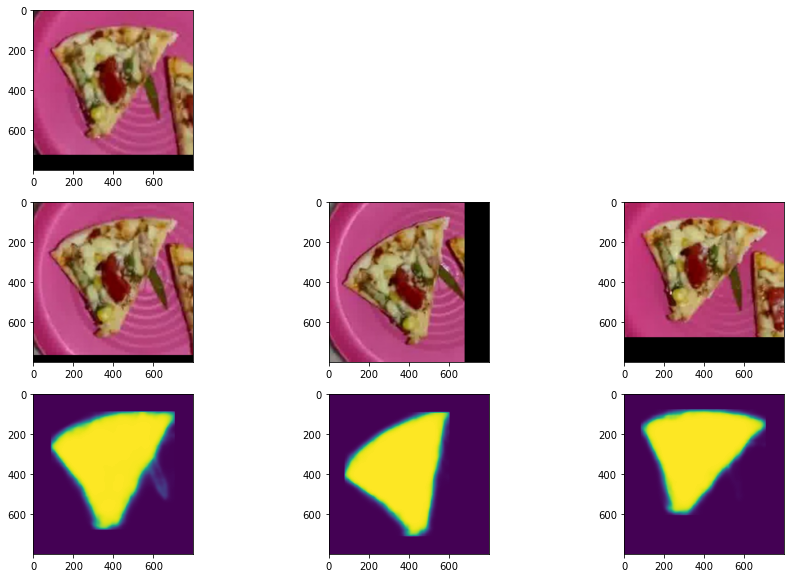

In [147]:
plt.figure(figsize=(15, 10))

plt.subplot(3, src_num, 1)
plt.imshow(ray_sampler.get_all()["rgb"].reshape(800, 800, 3).cpu().numpy())

for n_src in range(0, src_num):
    plt.subplot(3, src_num, src_num + (n_src+1))
    plt.imshow(srcs["rgb"][n_src].permute(1, 2, 0).cpu().numpy())

    plt.subplot(3, src_num, 2*src_num + (n_src+1))
    plt.imshow(srcs["mask"][n_src].permute(1, 2, 0).cpu().numpy())

In [148]:
H, W = ray_sampler.H, ray_sampler.W
gt_img = ray_sampler.rgb.reshape(H, W, 3)
gt_mask = ray_sampler.mask.reshape(H, W, 1)
gt_data = {"img":gt_img, "mask":gt_mask}

# COLMAP GT Camera로 렌더링 했을 때

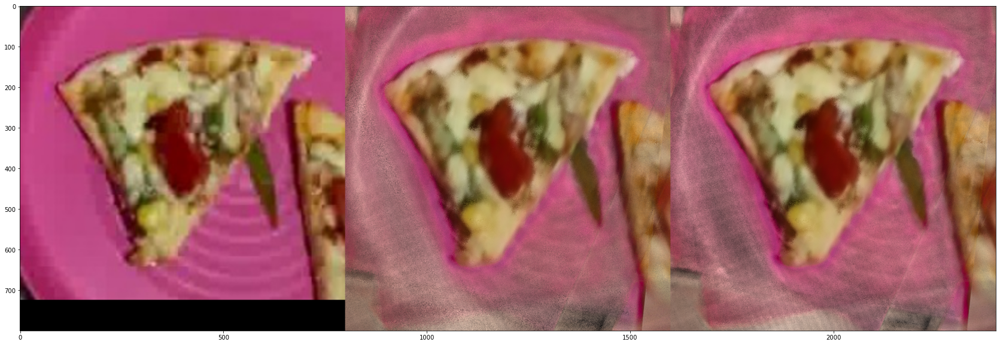

In [149]:
gt_camera_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, gt_camera_ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)

plt.figure(figsize=(30, 10))
plt.imshow(gt_camera_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

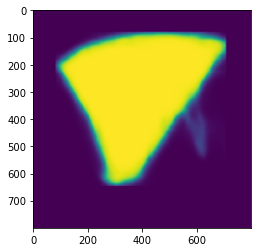

In [150]:
masking = ray_sampler.mask.reshape(800, 800).cpu().numpy()
plt.imshow(masking)

In [172]:
save_image(gt_camera_imgs["rgb"].cpu()[..., :800], "imgs/pizza_target.png")
save_image(gt_camera_imgs["src"].cpu(), "imgs/pizza_srcs.png")

# save_image(gt_camera_imgs["rgb"][..., -800:].cpu(), "imgs/bench_gt.png")
masking_gt_imgs = gt_camera_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_gt_imgs[masking < 0.5] = 0.
masking_gt_imgs = Image.fromarray((masking_gt_imgs*255).astype(np.uint8))
masking_gt_imgs.save("imgs/pizza_gt.png")

# 최적화 전 Noise Camera로 렌더링 했을 때

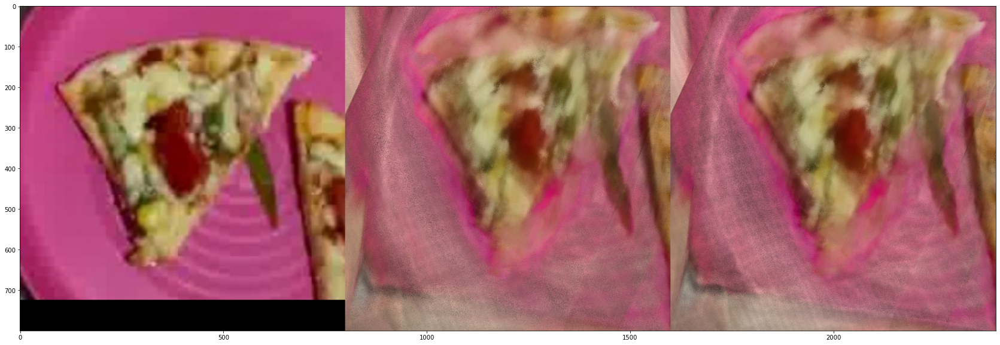

In [173]:
noise_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(noise_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

In [174]:
# save_image(noise_imgs["rgb"][..., -800:].cpu(), "imgs/bench_noise.png")
masking_noise_imgs = noise_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_noise_imgs[masking < 0.5] = 0.
masking_noise_imgs = Image.fromarray((masking_noise_imgs*255).astype(np.uint8))
masking_noise_imgs.save("imgs/pizza_noise.png")

-----------------------------------------------------

In [175]:
imgs = [gt_img.clone()] + list(torch.unbind(srcs["rgb"].clone().permute(0, 2, 3, 1)))

N_cam = model.hparams.N_src + 1

pair_idxs = []
for i in range(0, N_cam):
    for j in range(i+1, N_cam):
        pair_idxs.append((i, j))

In [176]:
# noise all cam
focal_lengths = torch.cat([initial_tgt_cams.focal_length.clone(), initial_src_cams.focal_length.clone()], dim=0)
principal_points = torch.cat([initial_tgt_cams.principal_point.clone(), initial_src_cams.principal_point.clone()], dim=0)
Rs = torch.cat([initial_tgt_cams.R.clone(), initial_src_cams.R.clone()], dim=0)
Ts = torch.cat([initial_tgt_cams.T.clone(), initial_src_cams.T.clone()], dim=0)

all_cam = PerspectiveCameras(
                            focal_length=focal_lengths,
                            principal_point=principal_points,
                            R=Rs,
                            T=Ts,
                        ).to(ray_batch["tgt_camera"].device)
initial_all_cam = all_cam.clone()


# gt all cam
gt_focal_lengths = torch.cat([gt_tgt_cams.focal_length.clone(), gt_src_cams.focal_length.clone()], dim=0)
gt_principal_points = torch.cat([gt_tgt_cams.principal_point.clone(), gt_src_cams.principal_point.clone()], dim=0)
gt_Rs = torch.cat([gt_tgt_cams.R.clone(), gt_src_cams.R.clone()], dim=0)
gt_Ts = torch.cat([gt_tgt_cams.T.clone(), gt_src_cams.T.clone()], dim=0)

gt_all_cam = PerspectiveCameras(
                            focal_length=gt_focal_lengths,
                            principal_point=gt_principal_points,
                            R=gt_Rs,
                            T=gt_Ts,
                        ).to(ray_batch["tgt_camera"].device)

In [177]:
rotation_base = all_cam.R.clone()
translation_base = all_cam.T.clone()

# rotation
delta_roll = nn.Parameter(torch.zeros(N_cam, device=all_cam.device))
delta_pitch = nn.Parameter(torch.zeros(N_cam, device=all_cam.device))
delta_yaw = nn.Parameter(torch.zeros(N_cam, device=all_cam.device))
# translation
delta_t = nn.Parameter(torch.zeros((N_cam, 3), device=all_cam.device))

optimizer = torch.optim.Adam([delta_roll, delta_pitch, delta_yaw, delta_t], lr=0.005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.8)

# optimizer = torch.optim.Adam([delta_roll, delta_pitch, delta_yaw, delta_t], lr=0.001)
# # scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.8)

In [178]:
# geometric photometric 한번에
optimized_cameras = []
delta_Rs = []
delta_Ts = []

with torch.autograd.set_detect_anomaly(True):
    correspondences = {}
    for pair_idx in pair_idxs:
        img1 = imgs[pair_idx[0]]
        img2 = imgs[pair_idx[1]]
        
        with torch.no_grad():
            result = runSuperGlueSinglePair(model.matcher, img1, img2, 0)
            result = preprocess_match(result)
            correspondences[pair_idx] = result
            
    camera_optim_step = 0
    min_loss = float('inf')
    for optim_step in range(camera_optim_step,camera_optim_step+300):
        if optim_step <= 70:
            ray_threshold = 15000.
        elif optim_step <= 120:
            ray_threshold = 1000.
        elif optim_step < 200:
            ray_threshold = 200.
            
        optimizer.zero_grad()
    
        # camera parameters optimization
        delta_R = get_rotation_matrix_from_RPY(delta_roll, delta_pitch, delta_yaw)
        delta_T = delta_t

        R_new = torch.matmul(rotation_base, delta_R)
        T_new = translation_base + delta_T
        
        # camera update
        all_cam.R = R_new
        all_cam.T = T_new
        ray_batch["tgt_camera"].R = R_new[0][None]
        ray_batch["tgt_camera"].T = T_new[0][None]
        ray_batch["src_cameras"].R = R_new[1:]
        ray_batch["src_cameras"].T = T_new[1:]
        
        # optimized_cameras.append(all_cam.clone())
        # delta_Rs.append(delta_R.clone())
        # delta_Ts.append(delta_T.clone())
        
        total_loss = 0.
        
        ########################## Photometric Consistencty Loss (RGB, Mask) ##########################
        # Pretrained Nerformer Inference
        output = render_rays(ray_batch, model.nerformer, model.nerformer, feature_maps, model.hparams.pe_dim,
                            model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det,
                            model.hparams.model_type, model.hparams.with_colmap, 1)
        
        # Coarse Loss
        coarse_rgb_loss = model.masked_mse_loss(output["outputs_coarse"]["rgb"], ray_batch["rgb"], ray_batch["mask"])
        coarse_mask_loss = model.bce_loss(output["outputs_coarse"]["mask"][..., 0], ray_batch["mask"]) * model.hparams.lambda_mask
        coarse_loss = (coarse_rgb_loss + coarse_mask_loss)

        # Fine Loss
        fine_rgb_loss = model.masked_mse_loss(output["outputs_fine"]["rgb"], ray_batch["rgb"], ray_batch["mask"])
        fine_mask_loss = model.bce_loss(output["outputs_fine"]["mask"][..., 0], ray_batch["mask"]) * model.hparams.lambda_mask
        fine_loss = (fine_rgb_loss + fine_mask_loss)
        
        total_loss += (coarse_loss + fine_loss)
    
        ######################### Geometric Consistency Loss (proj_ray_dist) ##########################
        projected_ray_results = {}
        proj_ray_dist = 0.
        # 각 이미지 페어에 대해서 projected ray distance 측정
        for pair_idx in pair_idxs:
            img1 = imgs[pair_idx[0]]
            img2 = imgs[pair_idx[1]]

            result = correspondences[pair_idx]
                                        
            # correspondence pairs가 존재하고, 또 그 개수가 꽤 많이 나왔다면... (서로 가까운 위치의 카메라 & correspondences의 신뢰도 높음)
            if result[0] != None and len(result[0]) >= 20:
                pair_rays = get_pair_rays(pair_idx, all_cam, 800, 800, result)
                loss = proj_ray_dist_loss_single(result[0], result[1], all_cam, pair_idx, pair_rays, 
                                                "train", 800, 800, proj_ray_dist_threshold=ray_threshold)[0]
                proj_ray_dist += torch.nan_to_num(loss)

                projected_ray_results[str(pair_idx)] = {"result": result, "pair_rays": pair_rays}
            else:
                projected_ray_results[str(pair_idx)] = None
        total_loss += proj_ray_dist # * model.hparams.lambda_ray
        
        total_loss.backward()
        optimizer.step()
        scheduler.step()
        print("[Step %d] : %f"%(optim_step, total_loss.item()))
        
        if min_loss > total_loss:
            min_R_new = R_new.clone()
            min_T_new = T_new.clone()
            min_loss = total_loss
    print("min loss: ", min_loss)
    ray_batch["tgt_camera"].R = min_R_new[0][None]
    ray_batch["tgt_camera"].T = min_T_new[0][None]
    ray_batch["src_cameras"].R = min_R_new[1:]
    ray_batch["src_cameras"].T = min_T_new[1:]
        

[Step 0] : 14129.726562
[Step 1] : 12795.130859
[Step 2] : 11518.020508
[Step 3] : 10369.450195
[Step 4] : 9184.546875
[Step 5] : 8052.421387
[Step 6] : 21394.193359
[Step 7] : 19956.494141
[Step 8] : 19125.390625
[Step 9] : 17896.357422
[Step 10] : 16731.386719
[Step 11] : 15523.993164
[Step 12] : 14453.708984
[Step 13] : 13513.578125
[Step 14] : 12778.975586
[Step 15] : 12315.232422
[Step 16] : 11604.642578
[Step 17] : 11138.813477
[Step 18] : 10474.986328
[Step 19] : 10259.107422
[Step 20] : 9643.688477
[Step 21] : 9500.858398
[Step 22] : 9177.908203
[Step 23] : 8638.939453
[Step 24] : 7763.383301
[Step 25] : 7422.815430
[Step 26] : 6869.300781
[Step 27] : 6199.778320
[Step 28] : 5677.430176
[Step 29] : 5176.456543
[Step 30] : 4748.014648
[Step 31] : 4698.953125
[Step 32] : 4486.997070
[Step 33] : 3916.309326
[Step 34] : 3912.628174
[Step 35] : 3793.388672
[Step 36] : 3327.021240
[Step 37] : 3290.334717
[Step 38] : 3164.106201
[Step 39] : 2957.691895
[Step 40] : 2740.619629
[Step 41

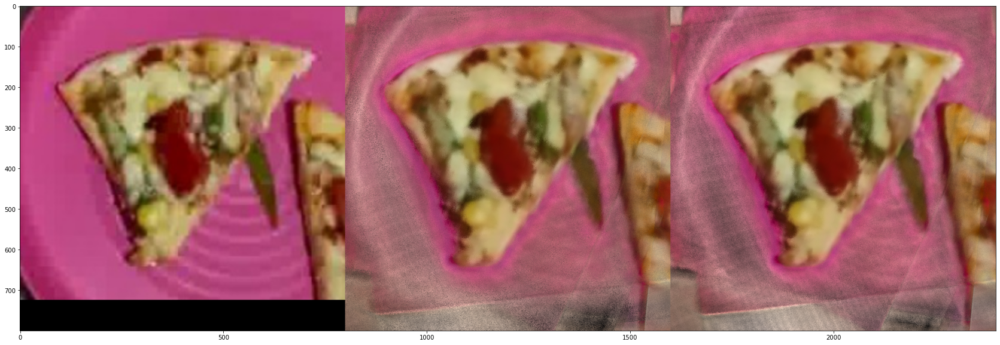

In [155]:
gt_join300_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(gt_join300_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

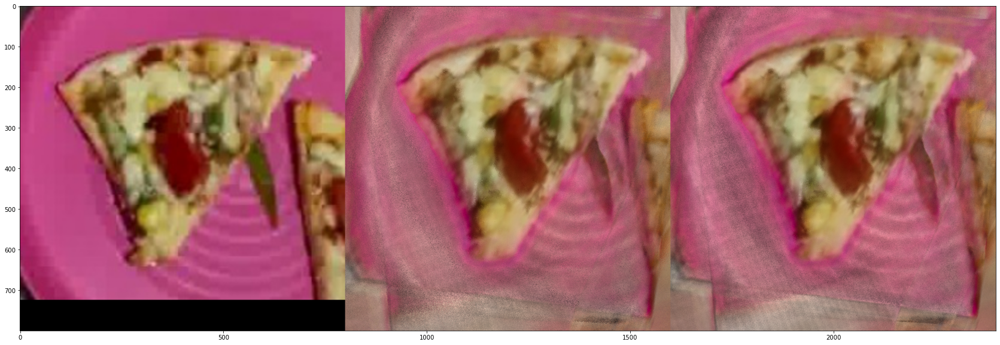

In [179]:
join300_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(join300_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

In [180]:
# # save_image(masking_join300_imgs, "imgs/bench_optim_gt_join300.png")

masking_gt_join300_imgs = gt_join300_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_gt_join300_imgs[masking < 0.5] = 0.
masking_gt_join300_imgs = Image.fromarray((masking_gt_join300_imgs*255).astype(np.uint8))
masking_gt_join300_imgs.save("imgs/pizza_optim_gt_join300.png")

masking_join300_imgs = join300_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_join300_imgs[masking < 0.5] = 0.
masking_join300_imgs = Image.fromarray((masking_join300_imgs*255).astype(np.uint8))
masking_join300_imgs.save("imgs/pizza_optim_join300.png")

In [167]:

focal_lengths = torch.cat([gt_tgt_cams.focal_length.clone(), gt_src_cams.focal_length.clone()], dim=0)
principal_points = torch.cat([gt_tgt_cams.principal_point.clone(), gt_src_cams.principal_point.clone()], dim=0)
Rs = torch.cat([gt_tgt_cams.R.clone(), gt_src_cams.R.clone()], dim=0)
Ts = torch.cat([gt_tgt_cams.T.clone(), gt_src_cams.T.clone()], dim=0)

all_cam = PerspectiveCameras(
                            focal_length=focal_lengths,
                            principal_point=principal_points,
                            R=Rs,
                            T=Ts,
                        ).to(ray_batch["tgt_camera"].device)

In [194]:
focal_lengths = torch.cat([initial_tgt_cams.focal_length.clone(), initial_src_cams.focal_length.clone()], dim=0)
principal_points = torch.cat([initial_tgt_cams.principal_point.clone(), initial_src_cams.principal_point.clone()], dim=0)
Rs = torch.cat([initial_tgt_cams.R.clone(), initial_src_cams.R.clone()], dim=0)
Ts = torch.cat([initial_tgt_cams.T.clone(), initial_src_cams.T.clone()], dim=0)

all_cam = PerspectiveCameras(
                            focal_length=focal_lengths,
                            principal_point=principal_points,
                            R=Rs,
                            T=Ts,
                        ).to(ray_batch["tgt_camera"].device)

In [195]:
rotation_base = all_cam.R.clone()
translation_base = all_cam.T.clone()

# rotation
delta_roll = nn.Parameter(torch.zeros(N_cam, device=all_cam.device))
delta_pitch = nn.Parameter(torch.zeros(N_cam, device=all_cam.device))
delta_yaw = nn.Parameter(torch.zeros(N_cam, device=all_cam.device))
# translation
delta_t = nn.Parameter(torch.zeros((N_cam, 3), device=all_cam.device))

optimizer = torch.optim.Adam([delta_roll, delta_pitch, delta_yaw, delta_t], lr=0.005)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.8)

# optimizer = torch.optim.Adam([delta_roll, delta_pitch, delta_yaw, delta_t], lr=0.001)
# # scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=50, gamma=0.8)

In [196]:
# geometric photometric 따로
optimized_cameras = []
delta_Rs = []
delta_Ts = []

with torch.autograd.set_detect_anomaly(True):
    correspondences = {}
    for pair_idx in pair_idxs:
        img1 = imgs[pair_idx[0]]
        img2 = imgs[pair_idx[1]]
        
        with torch.no_grad():
            result = runSuperGlueSinglePair(model.matcher, img1, img2, 0)
            result = preprocess_match(result)
            correspondences[pair_idx] = result
    
    camera_optim_step = 0
    min_loss = float('inf')
    # optim_method = "photometric"
    optim_method = "geometric"
    print("Optimize using Geometric Consistency")
    for optim_step in range(camera_optim_step,camera_optim_step+300):
        if optim_step <= 70:
            ray_threshold = 150000.
        elif optim_step <= 120:
            ray_threshold = 1000.
        elif optim_step < 200:
            ray_threshold = 200.
        elif optim_step == 200:
            optim_method = "photometric"
            print("Optimize using Photometric Consistency")
            
            print("geo min loss: ", min_loss)
            ray_batch["tgt_camera"].R = min_R_new[0][None]
            ray_batch["tgt_camera"].T = min_T_new[0][None]
            ray_batch["src_cameras"].R = min_R_new[1:]
            ray_batch["src_cameras"].T = min_T_new[1:]
            min_loss = float('inf')
            
        optimizer.zero_grad()
    
        # camera parameters optimization
        delta_R = get_rotation_matrix_from_RPY(delta_roll, delta_pitch, delta_yaw)
        delta_T = delta_t

        R_new = torch.matmul(rotation_base, delta_R)
        T_new = translation_base + delta_T
        
        # camera update
        all_cam.R = R_new
        all_cam.T = T_new
        ray_batch["tgt_camera"].R = R_new[0][None]
        ray_batch["tgt_camera"].T = T_new[0][None]
        ray_batch["src_cameras"].R = R_new[1:]
        ray_batch["src_cameras"].T = T_new[1:]
        
        optimized_cameras.append(all_cam.clone())
        delta_Rs.append(delta_R.clone())
        delta_Ts.append(delta_T.clone())
        
        total_loss = 0.
        if optim_method == "photometric":
            ########################## Photometric Consistencty Loss (RGB, Mask) ##########################
            # Pretrained Nerformer Inference
            output = render_rays(ray_batch, model.nerformer, model.nerformer, feature_maps, model.hparams.pe_dim,
                                model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det,
                                model.hparams.model_type, model.hparams.with_colmap, 1)
            
            # Coarse Loss
            coarse_rgb_loss = model.masked_mse_loss(output["outputs_coarse"]["rgb"], ray_batch["rgb"], ray_batch["mask"])
            coarse_mask_loss = model.bce_loss(output["outputs_coarse"]["mask"][..., 0], ray_batch["mask"]) * model.hparams.lambda_mask
            coarse_loss = (coarse_rgb_loss + coarse_mask_loss)

            # Fine Loss
            fine_rgb_loss = model.masked_mse_loss(output["outputs_fine"]["rgb"], ray_batch["rgb"], ray_batch["mask"])
            fine_mask_loss = model.bce_loss(output["outputs_fine"]["mask"][..., 0], ray_batch["mask"]) * model.hparams.lambda_mask
            fine_loss = (fine_rgb_loss + fine_mask_loss)
            
            total_loss += (coarse_loss + fine_loss)
        else:
            ######################### Geometric Consistency Loss (proj_ray_dist) ##########################
            # projected_ray_results = {}
            proj_ray_dist = 0.
            # 각 이미지 페어에 대해서 projected ray distance 측정
            for pair_idx in pair_idxs:
                img1 = imgs[pair_idx[0]]
                img2 = imgs[pair_idx[1]]

                result = correspondences[pair_idx]
                
                # correspondence pairs가 존재하고, 또 그 개수가 꽤 많이 나왔다면... (서로 가까운 위치의 카메라 & correspondences의 신뢰도 높음)
                if result[0] != None and len(result[0]) >= 20:
                    pair_rays = get_pair_rays(pair_idx, all_cam, 800, 800, result)
                    loss = proj_ray_dist_loss_single(result[0], result[1], all_cam, pair_idx, pair_rays, 
                                                    "train", 800, 800, proj_ray_dist_threshold=ray_threshold)[0]
                    proj_ray_dist += torch.nan_to_num(loss)
                #     projected_ray_results[str(pair_idx)] = {"result": result, "pair_rays": pair_rays}
                # else:
                #     projected_ray_results[str(pair_idx)] = None
                
            total_loss += proj_ray_dist # * model.hparams.lambda_ray
        
        total_loss.backward()
        optimizer.step()
        scheduler.step()
        print("[Step %d] : %f"%(optim_step, total_loss.item()))
        
        if min_loss > total_loss:
            min_R_new = R_new.clone()
            min_T_new = T_new.clone()
            min_loss = total_loss
    print("min loss: ", min_loss)
    ray_batch["tgt_camera"].R = min_R_new[0][None]
    ray_batch["tgt_camera"].T = min_T_new[0][None]
    ray_batch["src_cameras"].R = min_R_new[1:]
    ray_batch["src_cameras"].T = min_T_new[1:]
        

Optimize using Geometric Consistency
[Step 0] : 45564.363281
[Step 1] : 34350.148438
[Step 2] : 30502.728516
[Step 3] : 26704.462891
[Step 4] : 24039.134766
[Step 5] : 22216.228516
[Step 6] : 19822.820312
[Step 7] : 17747.236328
[Step 8] : 16121.540039
[Step 9] : 14625.876953
[Step 10] : 13495.446289
[Step 11] : 12141.646484
[Step 12] : 10939.697266
[Step 13] : 10341.712891
[Step 14] : 9927.423828
[Step 15] : 9425.000000
[Step 16] : 8777.849609
[Step 17] : 8296.664062
[Step 18] : 8011.026855
[Step 19] : 7686.753906
[Step 20] : 7506.400879
[Step 21] : 6762.806641
[Step 22] : 6090.582520
[Step 23] : 5964.852051
[Step 24] : 5412.624023
[Step 25] : 5482.488281
[Step 26] : 4771.806152
[Step 27] : 4370.458984
[Step 28] : 4065.827637
[Step 29] : 3755.651367
[Step 30] : 3579.900146
[Step 31] : 3663.566895
[Step 32] : 3364.467285
[Step 33] : 3299.123535
[Step 34] : 3319.820557
[Step 35] : 3059.196289
[Step 36] : 3212.617920
[Step 37] : 3317.211670
[Step 38] : 3165.260254
[Step 39] : 2873.333740

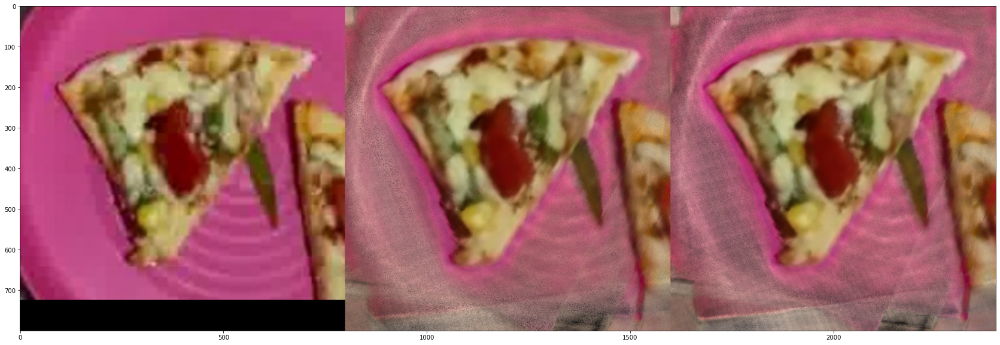

In [170]:
gt_photo300_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(gt_photo300_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

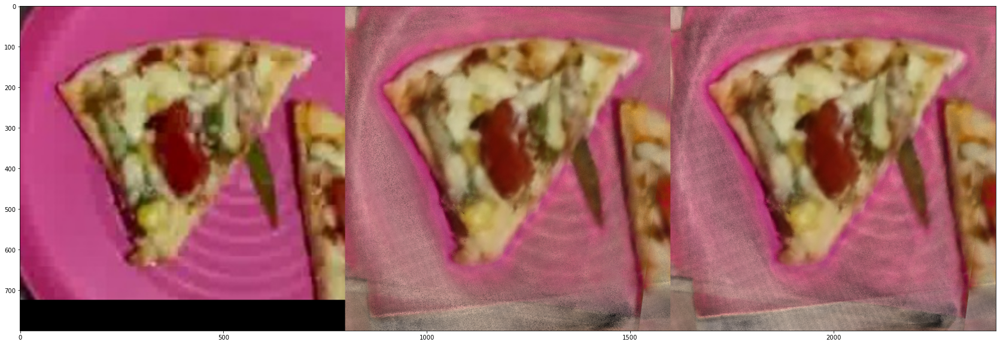

In [187]:
photo300_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(photo300_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

In [188]:
# save_image(photo300_imgs["rgb"][..., -800:], "imgs/hotdog_optim_p300.png")

masking_photo300_imgs = gt_photo300_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_photo300_imgs[masking < 0.5] = 0.
masking_photo300_imgs = Image.fromarray((masking_photo300_imgs*255).astype(np.uint8))
masking_photo300_imgs.save("imgs/pizza_optim_gt_p300.png")

masking_photo300_imgs = photo300_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_photo300_imgs[masking < 0.5] = 0.
masking_photo300_imgs = Image.fromarray((masking_photo300_imgs*255).astype(np.uint8))
masking_photo300_imgs.save("imgs/pizza_optim_p300.png")

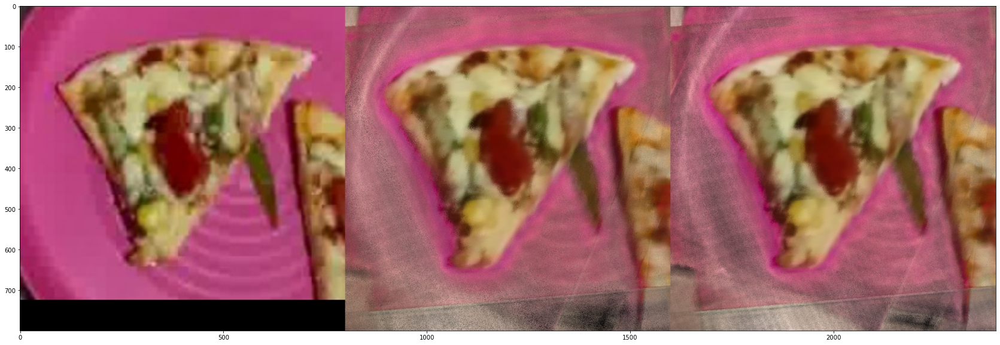

In [166]:
gt_geo300_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(gt_geo300_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

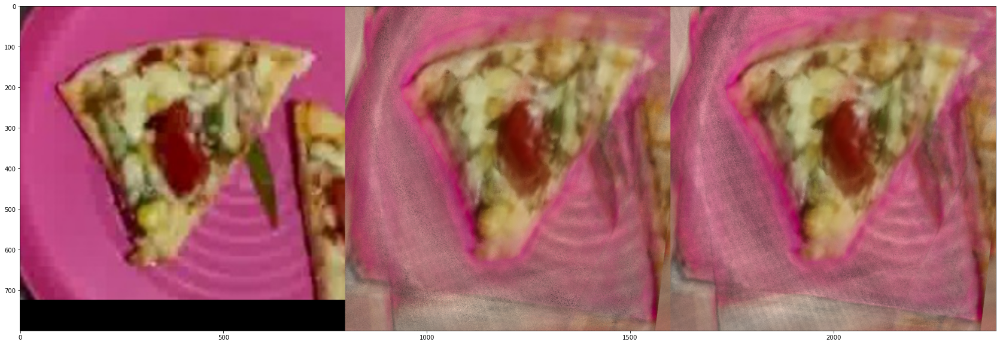

In [192]:
geo300_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(geo300_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

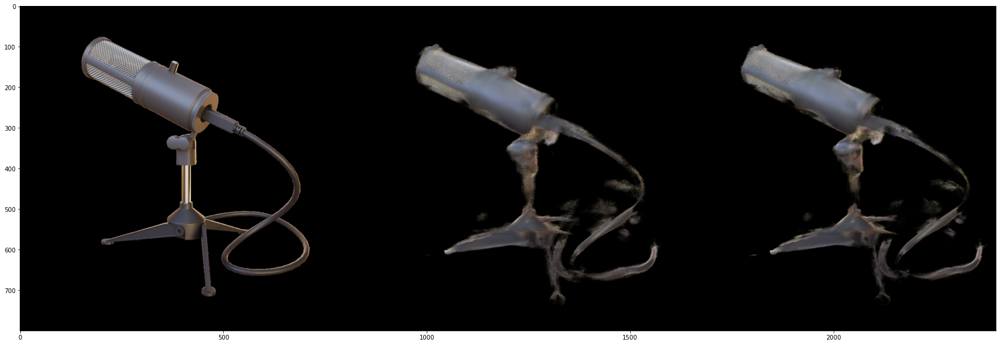

In [74]:
geo300_photo100_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(geo300_photo100_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

In [193]:
# save_image(geo300_imgs["rgb"][..., -800:], "imgs/hotdog_optim_g300.png")

masking_geo300_imgs = gt_geo300_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_geo300_imgs[masking < 0.5] = 0.
masking_geo300_imgs = Image.fromarray((masking_geo300_imgs*255).astype(np.uint8))
masking_geo300_imgs.save("imgs/pizza_optim_gt_g300.png")

masking_geo300_imgs = geo300_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_geo300_imgs[masking < 0.5] = 0.
masking_geo300_imgs = Image.fromarray((masking_geo300_imgs*255).astype(np.uint8))
masking_geo300_imgs.save("imgs/pizza_optim_g300.png")

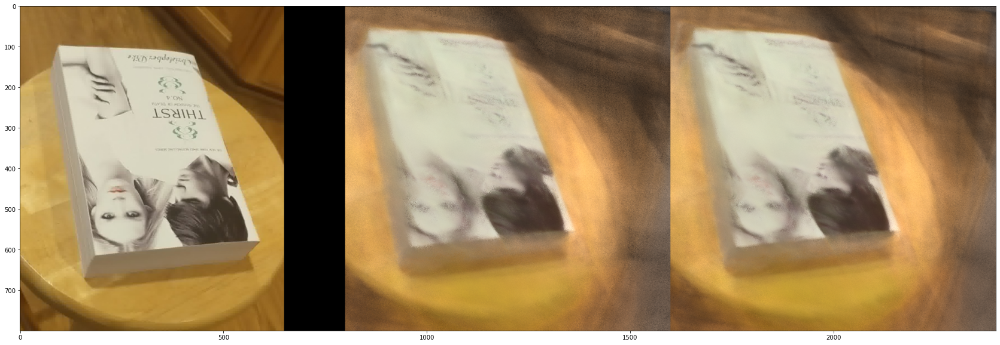

In [89]:
geo200_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(geo200_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

In [54]:
save_image(geo200_imgs["rgb"][..., -800:], "imgs/hotdog_optim_g200.png")

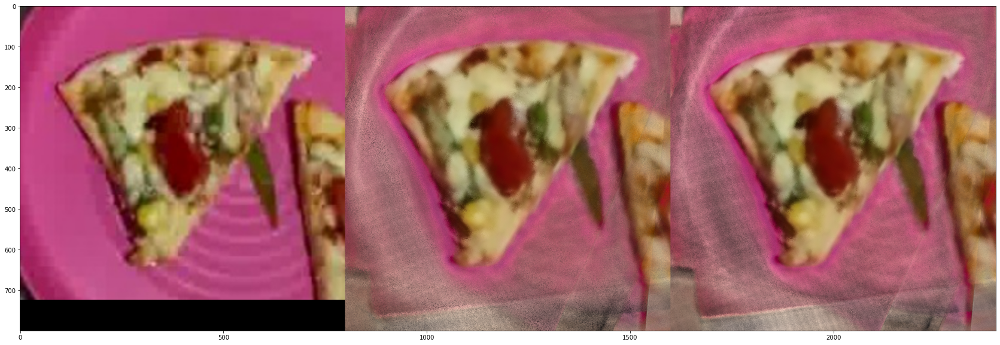

In [159]:
gt_geo200_photo100_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(gt_geo200_photo100_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

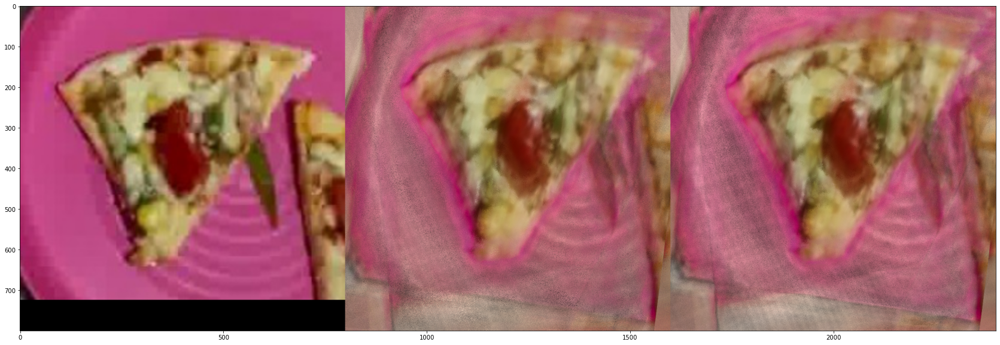

In [197]:
geo200_photo100_imgs = log_view_to_tensorboard_pl(model.nerformer, model.nerformer, ray_sampler, feature_maps, srcs, model.hparams.pe_dim, gt_data,
                                    model.hparams.chunk_size, model.hparams.render_stride,
                                    model.hparams.N_samples, model.hparams.N_importance, model.hparams.inv_uniform, model.hparams.det, 
                                    model.hparams.model_type, model.hparams.with_colmap, 1, masking=False)
plt.figure(figsize=(30, 10))
plt.imshow(geo200_photo100_imgs["rgb"].permute(1, 2, 0).cpu().numpy())

In [198]:
# save_image(geo200_photo100_imgs["rgb"][..., -800:], "imgs/hotdog_optim_g200_p100.png")

masking_gt_geo200_photo100_imgs = gt_geo200_photo100_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_gt_geo200_photo100_imgs[masking < 0.5] = 0.
masking_gt_geo200_photo100_imgs = Image.fromarray((masking_gt_geo200_photo100_imgs*255).astype(np.uint8))
masking_gt_geo200_photo100_imgs.save("imgs/pizza_optim_gt_g200_p100.png")

masking_geo200_photo100_imgs = geo200_photo100_imgs["rgb"][..., -800:].clone().permute(1, 2, 0).cpu().numpy()
masking_geo200_photo100_imgs[masking < 0.5] = 0.
masking_geo200_photo100_imgs = Image.fromarray((masking_geo200_photo100_imgs*255).astype(np.uint8))
masking_geo200_photo100_imgs.save("imgs/pizza_optim_g200_p100.png")

In [227]:
pair_idx = pair_idxs[0]
img1 = imgs[pair_idx[0]].cpu().numpy()
img2 = imgs[pair_idx[1]].cpu().numpy()
result = correspondences[pair_idx]
print(result.shape)

plt.figure(figsize=(16, 8))
plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1, bottom=0, top=1)

corr_idx = 100
pair_rays = get_pair_rays(pair_idx, all_cam, 800, 800, result)
proj_a, proj_b = proj_ray_dist_loss_single(result[0], result[1], initial_all_cam, pair_idx, pair_rays, 
                                                    "train", 800, 800, proj_ray_dist_threshold=ray_threshold, only_projection_points=True, projection_point_idx=corr_idx)

plt.subplot(1, 2, 1)
plt.imshow(img1)
for x, y in result[0][corr_idx:corr_idx+1]:
    print(x, y)
    print(proj_a)
    x = x.item()
    y = y.item()
    plt.scatter(x, y, s=100, cmap="yellow")
    plt.scatter(proj_a[0, 0].item(), proj_a[0, 1].item(), s=100, cmap="red", marker='*')
    
plt.subplot(1, 2, 2)
plt.imshow(img2)
for x, y in result[1][corr_idx:corr_idx+1]:
    print(x, y)
    print(proj_b)
    x = x.item()
    y = y.item()
    plt.scatter(x, y, s=100, cmap="yellow")
    plt.scatter(proj_b[0, 0].item(), proj_b[0, 1].item(), s=100, cmap="red", marker='*')

RuntimeError: CUDA error: device-side assert triggered

In [131]:
((proj_b - result[1][corr_idx:corr_idx+1])**2).sum()

tensor(2409.6978, device='cuda:0', grad_fn=<SumBackward0>)

In [132]:
(proj_b - result[1][corr_idx:corr_idx+1])

tensor([[-48.7776,  -5.5171]], device='cuda:0', grad_fn=<SubBackward0>)

In [120]:
pair_idx = pair_idxs[0]
img1 = imgs[pair_idx[0]].cpu().numpy()
img2 = imgs[pair_idx[1]].cpu().numpy()
result = correspondences[pair_idx]

pair_rays = get_pair_rays(pair_idx, initial_all_cam, 800, 800, result)
print(proj_ray_dist_loss_single(result[0], result[1], initial_all_cam, pair_idx, pair_rays, 
                                                    "train", 800, 800, proj_ray_dist_threshold=5000.)[0])

tensor(4063.9980, device='cuda:0')


/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/kmuvcl/NVS/FastNeRFormer/notebook/../src/utils/utils.py:211: MatplotlibDeprecationWarning: 
The M attribute was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use self.axes.M instead.
  xs, ys, zs = proj3d.proj_transform(xs3d, ys3d, zs3d, renderer.M)


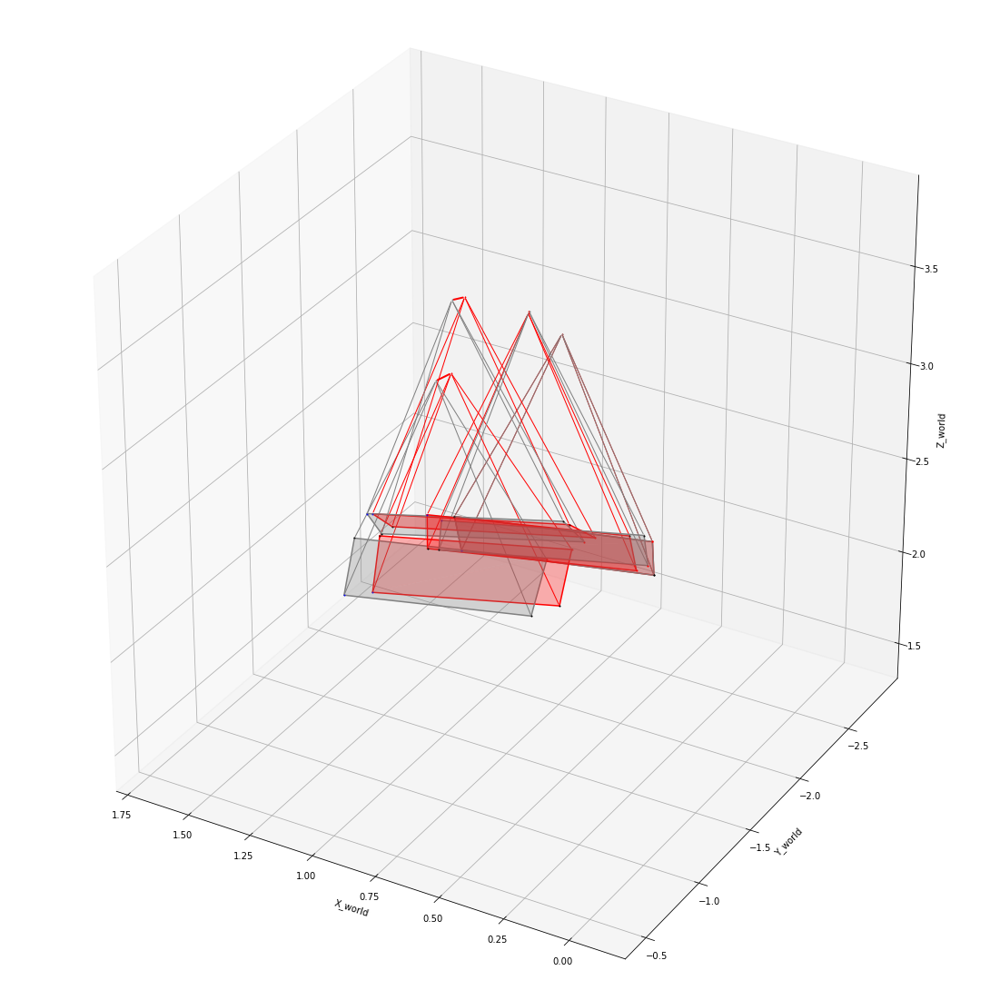

In [84]:
all_noisy_cam_figure = get_noise_camera_figure(gt_all_cam, [initial_all_cam], True)

/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/pytorch3d/transforms/transform3d.py:800: UserWarning: R is not a valid rotation matrix
  warnings.warn(msg)
/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/kmuvcl/NVS/FastNeRFormer/notebook/../src/utils/utils.py:211: MatplotlibDeprecationWarning: 
The M attribute was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use self.axes.M instead.
  xs, ys, zs = proj3d.proj_transform(xs3d, ys3d, zs3d, renderer.M)


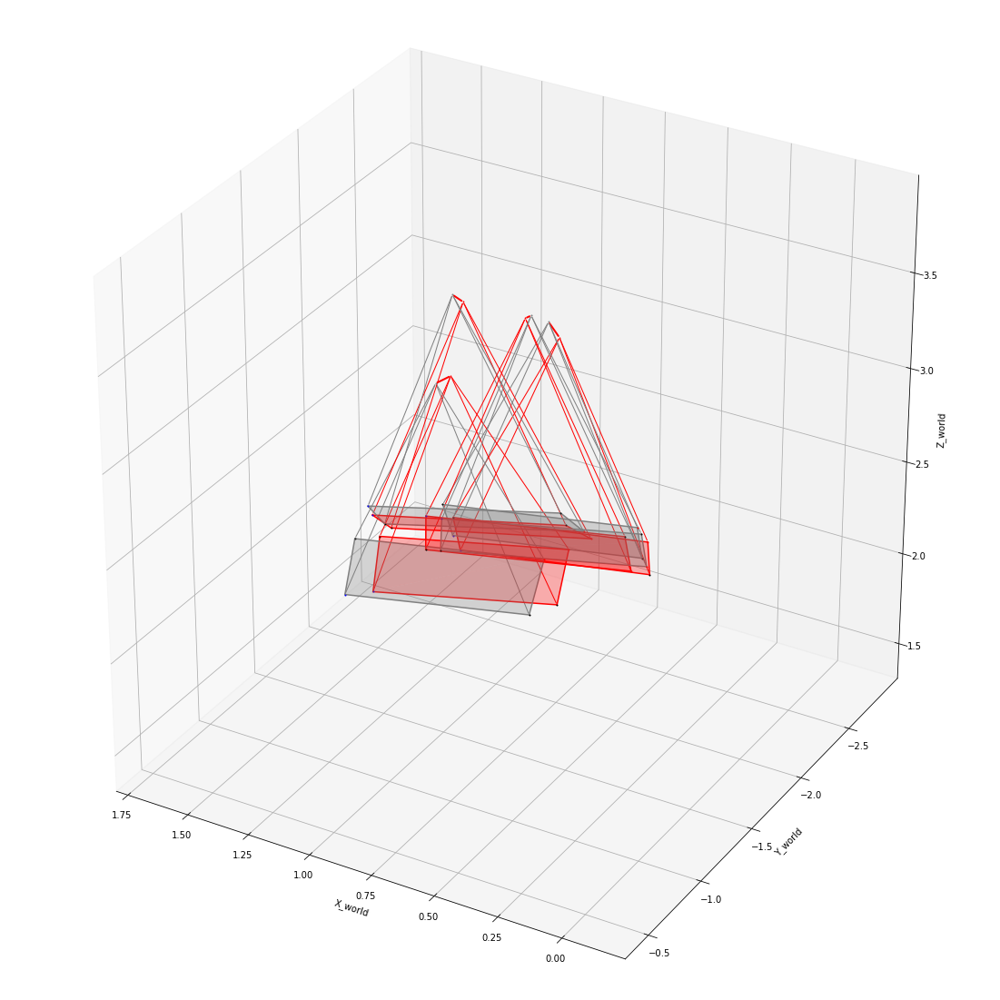

In [85]:
all_optimized_cam_figure = get_noise_camera_figure(gt_all_cam, [all_cam], True)

In [86]:
gt_w2c = gt_all_cam.get_world_to_view_transform().get_matrix()
optim_w2c = all_cam.get_world_to_view_transform().get_matrix()

optim_c2w = torch.inverse(optim_w2c)

# tgt과 srcs 사이의 relative pose 구하기
# srcs >>> tgt
relative_pose = torch.matmul(optim_c2w[0], gt_w2c[0])   # target 카메라를 기준으로 맞춰줌
print(relative_pose)

tensor([[ 1.0001,  0.0129, -0.0066,  0.0000],
        [-0.0126,  0.9995,  0.0182,  0.0000],
        [ 0.0068, -0.0178,  0.9997,  0.0000],
        [-0.0421,  0.0347, -0.0588,  1.0000]], device='cuda:0',
       grad_fn=<MmBackward>)


/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/pytorch3d/transforms/transform3d.py:800: UserWarning: R is not a valid rotation matrix
  warnings.warn(msg)


In [87]:
arange_optim_w2c = torch.matmul(optim_w2c, relative_pose)
arange_optim_R = arange_optim_w2c[..., :3, :3]
arange_optim_T = arange_optim_w2c[..., 3, :3]
arange_optim_cam = PerspectiveCameras(
                                focal_length=all_cam.focal_length[0].clone()[None],
                                principal_point=all_cam.principal_point[0].clone()[None],
                                R=arange_optim_R.clone(),      # row major
                                T=arange_optim_T.clone(),      # row major
                            ).to(all_cam.device)    

/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/kmuvcl/NVS/FastNeRFormer/notebook/../src/utils/utils.py:211: MatplotlibDeprecationWarning: 
The M attribute was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use self.axes.M instead.
  xs, ys, zs = proj3d.proj_transform(xs3d, ys3d, zs3d, renderer.M)


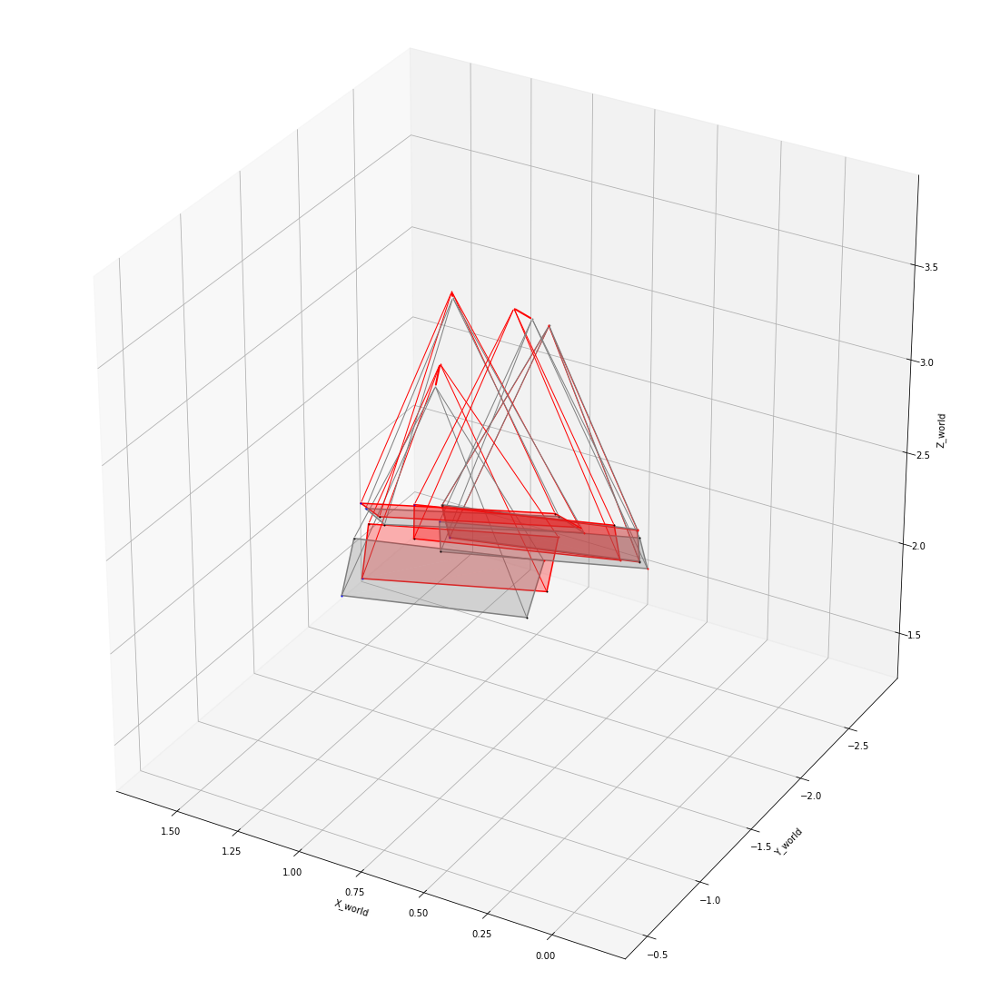

In [88]:
all_optimized_cam_arange_figure = get_noise_camera_figure(gt_all_cam, [arange_optim_cam], True)

In [123]:
all_noisy_cam_figure.savefig("arange_optimized_cam.png")

/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/lib/function_base.py:380: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis)
/home/kmuvcl/anaconda3/envs/pytorch3d/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/home/kmuvcl/NVS/FastNeRFormer/notebook/../src/utils/utils.py:211: MatplotlibDeprecationWarning: 
The M attribute was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use self.axes.M instead.
  xs, ys, zs = proj3d.proj_transform(xs3d, ys3d, zs3d, renderer.M)
